In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import random
from geopy.distance import geodesic
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
from tqdm import tqdm
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from scipy.spatial.distance import pdist, squareform
import math
import osmnx as ox
import networkx as nx
import folium
import geopandas as gpd
import numpy.random as rnd
from sklearn.neighbors import NearestCentroid
import plotly.express as px
from IPython.display import display, clear_output
import time
from geopy.geocoders import Nominatim
import pickle
from IPython.display import HTML
from prettytable import PrettyTable
from prettytable import DOUBLE_BORDER

## Reading the data

In [2]:
data = pd.read_csv('data_final.csv')

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3346108 entries, 0 to 3346107
Data columns (total 12 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   Crime ID               object 
 1   Month                  object 
 2   Reported by            object 
 3   Falls within           object 
 4   Longitude              float64
 5   Latitude               float64
 6   Location               object 
 7   LSOA code              object 
 8   LSOA name              object 
 9   Crime type             object 
 10  Last outcome category  object 
 11  Context                float64
dtypes: float64(3), object(9)
memory usage: 306.3+ MB


Deleting duplicated rows

In [4]:
data.drop_duplicates(inplace = True)
data.shape

(2881873, 12)

Deleting rows that contains NaN values in the columns *Longitude*, *Latitude*, *Crime type*, *Crime ID*, *Month*

In [5]:
data = pd.DataFrame(data[['Longitude','Latitude', 'Crime type', 'Crime ID', 'Month']])
data.dropna(inplace = True)
data = pd.DataFrame(data[['Longitude','Latitude', 'Crime type','Month']])
data.head(2)

,Longitude,Latitude,Crime type,Month
0,-0.112422,51.515381,Violence and sexual offences,2020-07
2,-0.098572,51.516767,Bicycle theft,2020-07


In [6]:
data.shape

(2398680, 4)

## Selection of crimes in the City of London

In [2]:
def calculate_distance(row):
    '''
    It takes a row of the dataframe and it computes 
    the geodesic distance between the centre of City of London
    and the place identified by the selected row.
    '''
    location_coords = (row['Latitude'], row['Longitude'])
    distance = geodesic(col_coords, location_coords).kilometers
    return distance

In [ ]:
# Coordinates of the center of city of london
col_coords = (51.5128, -0.0918)

# Calculate the distance for each location from center of City of London
data['Distance_from_CoL'] = data.apply(calculate_distance, axis=1)

In [ ]:
data.head(5)

In [9]:
# Setting a threshold distance in kilometers
threshold_distance = 2 
# Selecting places only if they have a distance from the City of London centre smaller than the threshold
locations_in_CoL = data[data['Distance_from_CoL'] <= threshold_distance]
# Selecting only the columns we'll need
df_new = locations_in_CoL[['Longitude', 'Latitude', 'Crime type', 'Month']]

Saving the final dataset in order to not repeat the above process everytime

In [23]:
df_new.to_csv('data_clean_year.csv', index = False)

## Crime scores

In [2]:
data = pd.read_csv('data_clean_year.csv')
data.head(1)

,Longitude,Latitude,Crime type,Month
0,-0.112422,51.515381,Violence and sexual offences,2020-07


Extracting the year of each crime from the column *Month*

In [3]:
def select_year(row):
    return row['Month'].split('-')[0]

data['year'] = data.apply(select_year, axis=1)

In [4]:
data.head(5)

,Longitude,Latitude,Crime type,Month,year
0,-0.112422,51.515381,Violence and sexual offences,2020-07,2020
1,-0.098572,51.516767,Bicycle theft,2020-07,2020
2,-0.096348,51.515472,Bicycle theft,2020-07,2020
3,-0.097562,51.518864,Bicycle theft,2020-07,2020
4,-0.096348,51.515472,Bicycle theft,2020-07,2020


In [5]:
# Checking how many places we have in the clean dataset 
data.shape

(92951, 5)

Let's see how many years we have

In [6]:
set(data['year'])

{'2020', '2021', '2022', '2023'}

Let's see how many different crime types we have

In [7]:
set(data['Crime type'])

{'Bicycle theft',
 'Burglary',
 'Criminal damage and arson',
 'Drugs',
 'Other crime',
 'Other theft',
 'Possession of weapons',
 'Public order',
 'Robbery',
 'Shoplifting',
 'Theft from the person',
 'Vehicle crime',
 'Violence and sexual offences'}

Since we don't have any info about *Other crime* and *Other theft* we've decided to drop all the reported crimes labelled that way

In [8]:
data = pd.DataFrame(data[data['Crime type'].isin(['Violence and sexual offences',
 'Possession of weapons',
 'Robbery',
 'Criminal damage and arson',
 'Public order',
 'Drugs',
 'Burglary',
 'Theft from the person',
 'Vehicle crime',
 'Bicycle theft',
 'Shoplifting'])])

In [9]:
data.shape

(71830, 5)

We can now add a score to each reported crime.\
We decided to assigne a score from 1 to 10 in increasing order of severity.

In [10]:
score = {
 'Violence and sexual offences': 10,
 'Possession of weapons':9,
 'Robbery': 8,
 'Criminal damage and arson': 7,
 'Public order': 6,
 'Drugs': 5,
 'Burglary': 4,
 'Theft from the person': 3,
 'Vehicle crime': 2,
 'Bicycle theft': 1,
 'Shoplifting': 1
        }

In [13]:
def assign_score(row):
    '''
    It takes in input a row of the Data Frame and returns the score
    associated to the type of crime 
    '''
    return score[row['Crime type']]

# Assigning a score to each row
data['Score'] = data.apply(assign_score, axis = 1)

In [14]:
data.head(5)

,Longitude,Latitude,Crime type,Month,year,Score
0,-0.112422,51.515381,Violence and sexual offences,2020-07,2020,10
1,-0.098572,51.516767,Bicycle theft,2020-07,2020,1
2,-0.096348,51.515472,Bicycle theft,2020-07,2020,1
3,-0.097562,51.518864,Bicycle theft,2020-07,2020,1
4,-0.096348,51.515472,Bicycle theft,2020-07,2020,1


Let's plot a barplot of the crimes type for each different year

In [15]:
order = list(score.keys())
order = order[::-1]

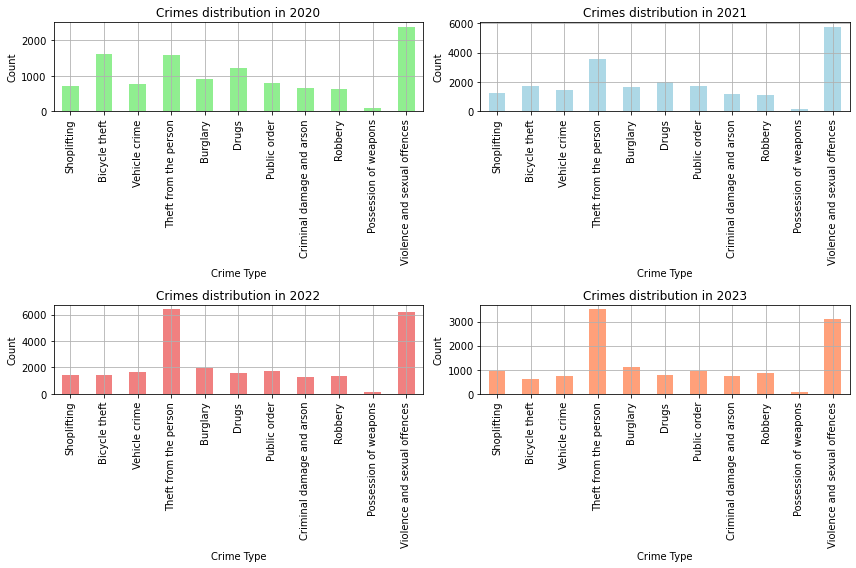

In [16]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))

count = data[data['year']=='2020']['Crime type'].value_counts()
count = count.reindex(order)
count.plot(kind='bar', color='lightgreen', ax=axes[0, 0])
axes[0, 0].set_title('Crimes distribution in 2020')
axes[0, 0].set_xlabel('Crime Type')
axes[0, 0].set_ylabel('Count')
axes[0, 0].grid(True)

count = data[data['year']=='2021']['Crime type'].value_counts()
count = count.reindex(order)
count.plot(kind='bar', color='lightblue', ax=axes[0, 1])
axes[0, 1].set_title('Crimes distribution in 2021')
axes[0, 1].set_xlabel('Crime Type')
axes[0, 1].set_ylabel('Count')
axes[0, 1].grid(True)

count = data[data['year']=='2022']['Crime type'].value_counts()
count = count.reindex(order)
count.plot(kind='bar', color='lightcoral', ax=axes[1, 0])
axes[1, 0].set_title('Crimes distribution in 2022')
axes[1, 0].set_xlabel('Crime Type')
axes[1, 0].set_ylabel('Count')
axes[1, 0].grid(True)

count = data[data['year']=='2023']['Crime type'].value_counts()
count = count.reindex(order)
count.plot(kind='bar', color='lightsalmon', ax=axes[1, 1])
axes[1, 1].set_title('Crimes distribution in 2023')
axes[1, 1].set_xlabel('Crime Type')
axes[1, 1].set_ylabel('Count')
axes[1, 1].grid(True)

plt.tight_layout()
plt.show()

As we can see from the next cell only about the $4\%$ of the rows contains unique geolocalization

In [17]:
app = round(data.groupby(['Latitude', 'Longitude']).nunique().shape[0]/data.shape[0],4)
print(app*100, '%')

3.58 %


We can summarise the data in order to have unique pairs *(lat,lon)* associating to each one a score computed considering the crime type and the year of each crime committed in a specific place

In [18]:
app = pd.DataFrame(data.groupby(['Longitude', 'Latitude','year']).sum('Score'))
app.reset_index(inplace= True)

year_weight = {'2020': 0.1, '2021': 0.2, '2022': 0.3, '2023': 0.4}

def weights_per_year(row):
    return year_weight[row['year']]*row['Score']

app['weighted_score'] = app.apply(weights_per_year, axis = 1)

In [19]:
app_2 = pd.DataFrame(app.groupby(['Longitude', 'Latitude']).sum('weighted_score'))
app_2.reset_index(inplace= True)
app_2.head(5)
data = pd.DataFrame(app_2[['Longitude', 'Latitude', 'weighted_score']])
data.head(5)

,Longitude,Latitude,weighted_score
0,-0.120571,51.512095,31.7
1,-0.120556,51.512103,41.9
2,-0.120500,51.512057,18.6
3,-0.120387,51.512020,13.5
4,-0.120338,51.514600,0.8


In [163]:
data.to_csv('data_summarized.csv', index = False)

In [23]:
data = pd.read_csv('data_summarized.csv')

## Clustering 

We'll now try different clustering methods and for each of them we'll use different techniques in order to find the best number of clusters for our purpose

In [24]:
clustering = pd.DataFrame(data[['Longitude', 'Latitude']])
weights = data['weighted_score']
k_try = range(5, 316, 10)

In [281]:
def clustering_score(clustering, type_clustering):
    silhouette = {}
    for k in tqdm(k_try):
        if type_clustering == 'kmeans':
            model = KMeans(n_clusters = k, random_state = 50180811)
            model.fit(clustering, sample_weight = weights)
        elif type_clustering == 'agglomerative':
            model = AgglomerativeClustering(n_clusters = k, linkage='ward')
            model.fit(clustering)
        silhouette[k] = metrics.silhouette_score(clustering,  model.labels_)
    return silhouette

### 1) K-means

In [282]:
silhouette_kmeans = clustering_score(clustering, 'kmeans')

100%|██████████████████████████████████████████████████████████████████████████████████| 32/32 [00:39<00:00,  1.22s/it]


#### Silhouette

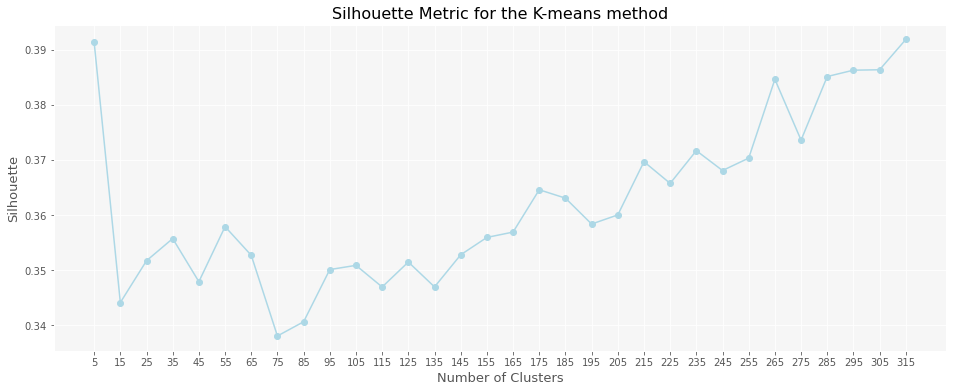

In [283]:
plt.style.use('ggplot')
plt.rcParams['axes.facecolor'] = (0.8275, 0.8275, 0.8275, 0.2)
plt.figure(figsize = (16,6))
plt.plot(silhouette_kmeans.keys(), silhouette_kmeans.values(), marker='o', linestyle='-', color='lightblue')
plt.grid(True)
plt.xticks(k_try, silhouette_kmeans.keys())
plt.title("Silhouette Metric for the K-means method", fontsize=16)
plt.xlabel("Number of Clusters", fontsize=13)
plt.ylabel("Silhouette", fontsize=13)
plt.show()

### Gap

In [286]:
B = 100
min_lat = clustering.Latitude.min()
max_lat = clustering.Latitude.max()
min_lon = clustering.Longitude.min()
max_lon = clustering.Longitude.max()
n = clustering.shape[0]

In [287]:
def euclidean_distance_cluster(df, k):
    distances = 0
    for c in range(k):
        app = pdist(df[df['Cluster']==c][['Latitude','Longitude']].values, metric='sqeuclidean')
        app = squareform(app).sum()
        distances += (app/df[df['Cluster']==c].shape[0])
    return distances

def K_means_W(df, k):
    model = KMeans(n_clusters = k, random_state = 50180811)
    model.fit(df, sample_weight=weights)
    if 'Cluster' in df.columns:
        df.drop('Cluster', axis = 1, inplace = True)
    df['Cluster'] = model.labels_
    return euclidean_distance_cluster(df, k)/2

In [ ]:
Gap_k = np.array([])
S_k = np.array([])
for k in tqdm(k_try):
    W_star = np.array([])
    W = K_means_W(clustering,k)
    for b in range(B):
        sim_data = pd.DataFrame({'Longitude' :  rnd.uniform(min_lon, max_lon, size=n), 'Latitude' : rnd.uniform(min_lat, max_lat, size=n)})
        W_star = np.append(W_star, K_means_W(sim_data,k))
    Gap_k = np.append(Gap_k, np.mean(np.log(W_star))-np.log(W))
    l = np.mean(np.log(W_star))
    sd = np.sqrt(np.mean((np.log(W_star)-l)**2))
    S_k = np.append(S_k, sd*(np.sqrt(1+(1/B))))

  6%|█████▏                                                                             | 2/32 [00:42<11:15, 22.51s/it]

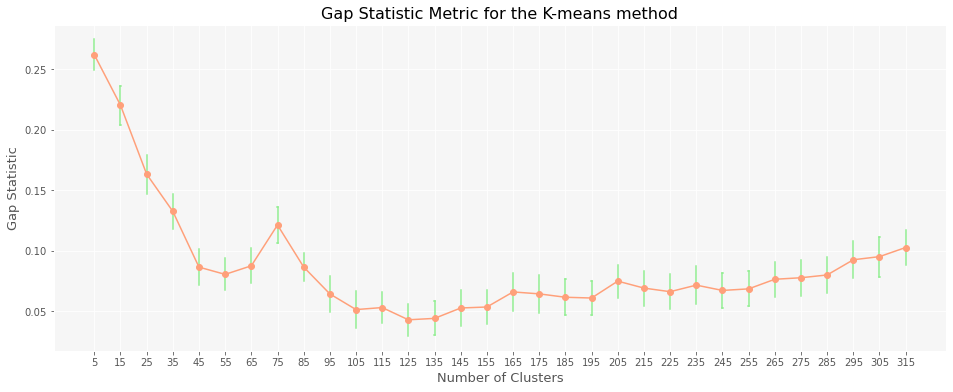

In [25]:
plt.style.use('ggplot')
plt.rcParams['axes.facecolor'] = (0.8275, 0.8275, 0.8275, 0.2)
plt.figure(figsize = (16,6))

for i in range(0,len(Gap_k)):
    horizontal_line_width=0.1
    left , right  = k_try[i] - horizontal_line_width / 2 , k_try[i] + horizontal_line_width / 2
    top = Gap_k[i] + S_k[i]
    bottom = Gap_k[i] - S_k[i]
    plt.plot([k_try[i], k_try[i]], [top, bottom], linestyle='-', color='lightgreen')
    plt.plot(k_try[i], Gap_k[i], 'o', color='lightsalmon', markersize = 6)
    plt.plot([left, right], [top, top], linestyle='-', color='lightgreen')
    plt.plot([left, right], [bottom, bottom], linestyle='-', color='lightgreen')

plt.grid(True)
plt.plot(list(k_try), Gap_k, linestyle='-', color='lightsalmon')
plt.xlabel("Number of Clusters", fontsize=13)
plt.ylabel("Gap Statistic", fontsize=13)
plt.title("Gap Statistic Metric for the K-means method", fontsize=16)   
plt.xticks(k_try)
plt.show()

In [ ]:
with open('Gap_kmeans.txt', 'w') as file:
    file.write('\n'.join(str(g) for g in Gap_k))
with open('S_kmeans.txt', 'w') as file:
    file.write('\n'.join(str(s) for s in S_k))

In [20]:
with open('Gap_kmeans.txt', 'r') as file:
    data = file.read().split('\n')
Gap_k = list(map(float, data))
with open('S_kmeans.txt', 'r') as file:
    data = file.read().split('\n')
S_k = list(map(float, data))

#### K-means with the best K 

We'll use two different $k$:
- $k=315$ as suggested from the Silhouette Score;
- $k=75$ as suggested from the Gap Statistic.

In [285]:
best_k_kmeans_1 = max(silhouette_kmeans, key = silhouette_kmeans.get)
best_k_kmeans_2 = 75

315

In [17]:
model_kmeans_1 = KMeans(n_clusters = best_k_kmeans_1 , random_state = 150180811)
model_kmeans_1.fit(clustering, sample_weight = weights)
data_kmeans_1 = pd.DataFrame(data)
data_kmeans_1['Cluster'] = model_kmeans_1.labels_

In [18]:
data_kmeans_1.head(5)

,Longitude,Latitude,weighted_score,Cluster
0,-0.120571,51.512095,31.7,143
1,-0.120556,51.512103,41.9,143
2,-0.120500,51.512057,18.6,143
3,-0.120387,51.512020,13.5,143
4,-0.120338,51.514600,0.8,160


In [20]:
centres_1 = model_kmeans_1.cluster_centers_
cluster_weights = pd.DataFrame(data_kmeans_1.groupby('Cluster').sum('weighted_score')).reset_index()['weighted_score']
data_kmeans_1['weights'] = np.nan
for i in range(len(centres_1)):
    data_kmeans_1.loc[data_kmeans_1['Cluster']==i, 'weights'] = cluster_weights[i]

Let's graphically show the clusters obtained with $k = 315$, for the clusters weights we'll use the sum of the weights of all the places in the cluster

In [27]:
fig = px.scatter_mapbox(data_kmeans_1, 
                        lat='Latitude',
                        lon='Longitude',
                        color='weights',
                        center={'lat':51.5128,
                                'lon':-0.0918},
                        zoom=12,
                  color_continuous_scale='Viridis_r', size_max=15)

fig.update_layout(mapbox_style='open-street-map')

fig.show()

In [22]:
data_kmeans_1.to_csv('data_kmeans_1.csv', index = False)

In [23]:
model_kmeans_2 = KMeans(n_clusters = best_k_kmeans_2 , random_state = 150180811)
model_kmeans_2.fit(clustering, sample_weight = weights)
data_kmeans_2 = pd.DataFrame(data)
data_kmeans_2['Cluster'] = model_kmeans_2.labels_

In [24]:
data_kmeans_2.head(5)

,Longitude,Latitude,weighted_score,Cluster,weights
0,-0.120571,51.512095,31.7,26,451.3
1,-0.120556,51.512103,41.9,26,451.3
2,-0.120500,51.512057,18.6,26,451.3
3,-0.120387,51.512020,13.5,26,451.3
4,-0.120338,51.514600,0.8,26,410.2


In [25]:
centres_2 = model_kmeans_2.cluster_centers_
cluster_weights = pd.DataFrame(data_kmeans_2.groupby('Cluster').sum('weighted_score')).reset_index()['weighted_score']
data_kmeans_2['weights'] = np.nan
for i in range(len(centres_2)):
    data_kmeans_2.loc[data_kmeans_2['Cluster']==i, 'weights'] = cluster_weights[i]

Clusters obtained with $k=75$

In [28]:
fig = px.scatter_mapbox(data_kmeans_2, 
                        lat='Latitude',
                        lon='Longitude',
                        color='weights',
                        center={'lat':51.5128,
                                'lon':-0.0918},
                        zoom=12,
                  color_continuous_scale='Viridis_r', size_max=15)
fig.update_layout(mapbox_style='open-street-map')

fig.show()

In [27]:
data_kmeans_2.to_csv('data_kmeans_2.csv', index = False)

### 2) Agglomerative

In [28]:
silhouette_agglomerative = clustering_score(clustering, 'agglomerative')

100%|██████████████████████████████████████████████████████████████████████████████████| 32/32 [00:08<00:00,  3.90it/s]


#### Silhouette

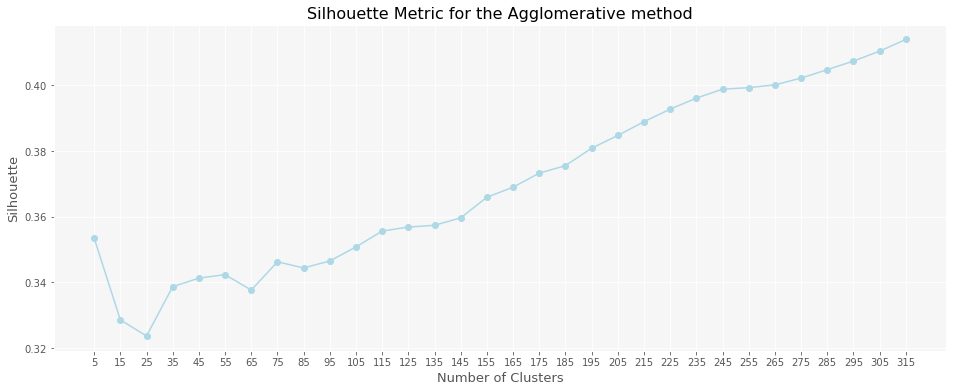

In [29]:
plt.style.use('ggplot')
plt.rcParams['axes.facecolor'] = (0.8275, 0.8275, 0.8275, 0.2)
plt.figure(figsize = (16,6))
plt.plot(silhouette_agglomerative.keys(), silhouette_agglomerative.values(), marker='o', linestyle='-', color='lightblue')
plt.grid(True)
plt.xticks(k_try, silhouette_agglomerative.keys())
plt.title("Silhouette Metric for the Agglomerative method", fontsize=16)
plt.xlabel("Number of Clusters", fontsize=13)
plt.ylabel("Silhouette", fontsize=13)
plt.show()

### GAP

In [ ]:
B = 100
min_lat = clustering.Latitude.min()
max_lat = clustering.Latitude.max()
min_lon = clustering.Longitude.min()
max_lon = clustering.Longitude.max()
n = clustering.shape[0]

In [ ]:
def euclidean_distance_cluster(df, k):
    distances = 0
    for c in range(k):
        app = pdist(df[df['Cluster']==c][['Latitude','Longitude']].values, metric='sqeuclidean')
        app = squareform(app).sum()
        distances += (app/df[df['Cluster']==c].shape[0])
    return distances

def agglomerative_W(df, k):
    model = AgglomerativeClustering(n_clusters = k, linkage='ward')
    model.fit(df)
    if 'Cluster' in df.columns:
        df.drop('Cluster', axis = 1, inplace = True)
    df['Cluster'] = model.labels_
    return euclidean_distance_cluster(df, k)/2

In [ ]:
Gap_a = np.array([])
S_a = np.array([])
for k in tqdm(k_try):
    W_star = np.array([])
    W = agglomerative_W(clustering,k)
    for b in range(B):
        sim_data = pd.DataFrame({'Longitude' :  rnd.uniform(min_lon, max_lon, size=n), 'Latitude' : rnd.uniform(min_lat, max_lat, size=n)})
        W_star = np.append(W_star, agglomerative_W(sim_data,k))
    Gap_a = np.append(Gap_a, np.mean(np.log(W_star))-np.log(W))
    l = np.mean(np.log(W_star))
    sd = np.sqrt(np.mean((np.log(W_star)-l)**2))
    S_a = np.append(S_a, sd*(np.sqrt(1+(1/B))))

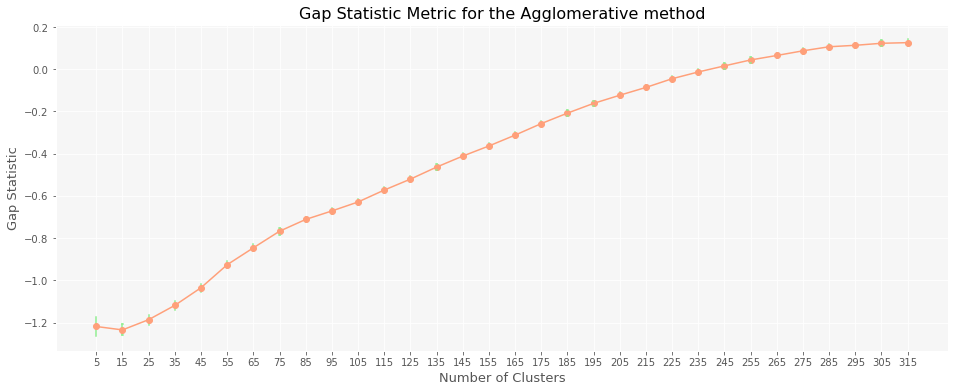

In [30]:
plt.style.use('ggplot')
plt.rcParams['axes.facecolor'] = (0.8275, 0.8275, 0.8275, 0.2)
plt.figure(figsize = (16,6))

for i in range(0,len(Gap_a)):
    horizontal_line_width=0.1
    left , right  = k_try[i] - horizontal_line_width / 2 , k_try[i] + horizontal_line_width / 2
    top = Gap_a[i] + S_a[i]
    bottom = Gap_a[i] - S_a[i]
    plt.plot([k_try[i], k_try[i]], [top, bottom], linestyle='-', color='lightgreen')
    plt.plot(k_try[i], Gap_a[i], 'o', color='lightsalmon', markersize = 6)
    plt.plot([left, right], [top, top], linestyle='-', color='lightgreen')
    plt.plot([left, right], [bottom, bottom], linestyle='-', color='lightgreen')
    
plt.grid(True)
plt.plot(list(k_try), Gap_a, linestyle='-', color='lightsalmon')
plt.xlabel("Number of Clusters", fontsize=13)
plt.ylabel("Gap Statistic", fontsize=13)
plt.title("Gap Statistic Metric for the Agglomerative method", fontsize=16)   
plt.xticks(k_try)
plt.show()

In [ ]:
with open('Gap_aggl.txt', 'w') as file:
    file.write('\n'.join(str(g) for g in Gap_a))
with open('S_aggl.txt', 'w') as file:
    file.write('\n'.join(str(s) for s in S_a))

In [29]:
with open('Gap_aggl.txt', 'r') as file:
    data = file.read().split('\n')
Gap_a = list(map(float, data))
with open('S_aggl.txt', 'r') as file:
    data = file.read().split('\n')
S_a = list(map(float, data))

#### Agglomerative with the best K

In [30]:
best_k_agglomerative = max(silhouette_agglomerative, key = silhouette_agglomerative.get)
best_k_agglomerative

315

In [31]:
model_agglomerative = AgglomerativeClustering(n_clusters = best_k_agglomerative , linkage='ward')
model_agglomerative.fit(clustering)
data_agglomerative = pd.DataFrame(data)
data_agglomerative['Cluster'] = model_agglomerative.labels_

In [32]:
data_agglomerative.head(1)

,Longitude,Latitude,weighted_score,Cluster,weights
0,-0.120571,51.512095,31.7,125,1702.5


In [33]:
labels_agg = model_agglomerative.fit(clustering).labels_
clf = NearestCentroid()
clf.fit(clustering, labels_agg)
centres_agg = clf.centroids_
cluster_weights = pd.DataFrame(data_agglomerative.groupby('Cluster').sum('weighted_score')).reset_index()['weighted_score']
data_agglomerative['weights'] = np.nan
for i in range(len(centres_agg)):
    data_agglomerative.loc[data_agglomerative['Cluster']==i, 'weights'] = cluster_weights[i]

Clusters obtained with the Agglomerative Clustering and with a $k=315$

In [31]:
fig = px.scatter_mapbox(data_agglomerative, 
                        lat='Latitude',
                        lon='Longitude',
                        color='weights',
                        center={'lat':51.5128,
                                'lon':-0.0918},
                        zoom=12,
                  color_continuous_scale='Viridis_r', size_max=15)
fig.update_layout(mapbox_style='open-street-map')

fig.show()

In [35]:
data_agglomerative.to_csv('data_agglomerative.csv', index = False)

## Safest path

Let's extract the graph  of the City of London that we'll need to compute the safest and shortest paths

In [36]:
center_point = (51.5128, -0.0918)
radius = 2000

g = ox.graph_from_point(
        center_point = center_point,
        dist = radius,
        network_type = "walk",
        dist_type = "bbox"
    )

def calculate_distance(point1, point2):
    return geodesic(point1, (point2['y'],point2['x'])).meters

# Extract the nodes within the selected radius
nodes_within_radius = [node for node in g.nodes() if calculate_distance(center_point, g.nodes[node]) <= radius]

# Create a subgraph from the extracted nodes
graph_km_1 = g.subgraph(nodes_within_radius)

# Saving the graph
ox.save_graph_geopackage(graph_km_1, 'graph.gpkg')

In [41]:
# Reading the graph as a GeoDataFrame
graph_data = gpd.read_file('graph.gpkg')

In [42]:
# Saving the GeoDataFram
graph_data.to_file('graph_data.geojson', driver='GeoJSON') 
graph_data = gpd.read_file('graph_data.geojson')

In [43]:
# Creating two identical graphs for the other two types of clustering 
graph_agg = graph_km_1.copy()
graph_km_2 = graph_km_1.copy()

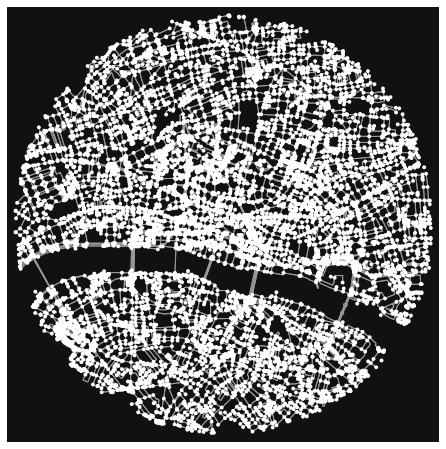

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [44]:
# Showing the obtained graph 
ox.plot_graph(graph_agg, show=True, close=False)

In [45]:
graph_data.head(10)

,osmid,y,x,street_count,highway,ref,geometry
0,104309,51.523483,-0.114935,3,,,POINT (-0.11494 51.52348)
1,104310,51.522986,-0.114502,3,,,POINT (-0.11450 51.52299)
2,104312,51.521514,-0.113320,4,,,POINT (-0.11332 51.52151)
3,104315,51.518176,-0.111381,4,,,POINT (-0.11138 51.51818)
4,104318,51.516230,-0.101924,3,,,POINT (-0.10192 51.51623)
5,104319,51.515372,-0.098808,4,crossing,,POINT (-0.09881 51.51537)
6,104320,51.514722,-0.096880,4,crossing,,POINT (-0.09688 51.51472)
7,104321,51.514218,-0.094741,3,,,POINT (-0.09474 51.51422)
8,104322,51.513823,-0.092329,4,,,POINT (-0.09233 51.51382)
9,104323,51.514049,-0.075242,3,,,POINT (-0.07524 51.51405)


In [46]:
graph_data.shape

(10835, 7)

#### Function for street weights

We can now assign a danger score to each edge of the graph as the ratio between the mean of the weights of near clusters and the mean of their distances from the edge itself.\
Clearly we'll obtained different street danger score for each different clustering model.

In [8]:
def street_weights(graph, graph_data, centres, df):
    weights_cluster = pd.DataFrame(df.groupby('Cluster').mean('weights'))['weights']
    neighbor = {}
    dist_from_centers = {}
    for node1, node2, data in tqdm(graph.edges(data = True)): 
        coordinates1 = float(graph_data[graph_data['osmid']== node1]['y']), float(graph_data[graph_data['osmid']== node1]['x'])
        coordinates2 = float(graph_data[graph_data['osmid']== node2]['y']), float(graph_data[graph_data['osmid']== node2]['x'])
        midpoint = ((coordinates1[1] + coordinates2[1])/2, (coordinates1[0] + coordinates2[0])/2)
        neighbor[(node1,node2)] = []
        dist_from_centers[(node1,node2)] = []

        average_dist = 0
        average_weights = 0
        threshold = 200
        
        for i in range(len(centres)): 
            dist = geodesic((centres[i][1], centres[i][0]), (midpoint[1],midpoint[0])).meters
            if dist <= threshold:
                dist_from_centers[(node1,node2)].append(dist)
                average_dist += dist
                average_weights += weights_cluster[i]
                neighbor[(node1,node2)].append(centres[i]) 
        if average_dist != 0:
            app1 = average_dist/(len(neighbor[(node1,node2)]))
            app2 = average_weights/(len(neighbor[(node1,node2)]))
            data['weigth'] = app2/app1
        else:
            data['weigth'] = 0
    return neighbor, dist_from_centers

**SAFEST** score Kmeans 

k = 315

In [84]:
centres_1 = model_kmeans_1.cluster_centers_

In [85]:
with open('centres_kmeans_1.csv', 'w') as f:
        for i in centres_1:
            np.savetxt(f,i)

In [9]:
centres_1 = np.loadtxt('centres_kmeans_1.csv')
centres_1 = centres_1.reshape(int(len(centres_1)/2),2)

In [10]:
neighbor_1, dist_from_centers_1 = street_weights(graph_km_1, graph_data, centres_1, data_kmeans_1)

with open('neighbor_1.pkl', 'wb') as f:
    pickle.dump(neighbor_1, f)
graph_km_1 = nx.MultiDiGraph(graph_km_1)
with open('graph_km_1.pkl', 'wb') as f:
    pickle.dump(graph_km_1, f)
with open('dist_from_centers_1.pkl', 'wb') as f:
    pickle.dump(dist_from_centers_1, f)

100%|██████████████████████████████████████████████████████████████████████████| 29418/29418 [2:18:48<00:00,  3.53it/s]


In [11]:
with open('neighbor_1.pkl', 'rb') as f:
    neighbor_1 = pickle.load(f)
with open('graph_km_1.pkl', 'rb') as f:
    graph_km_1 = pickle.load(f)
with open('dist_from_centers_1.pkl', 'rb') as f:
    dist_from_centers_1 = pickle.load(f)

k = 75

In [89]:
centres_2 = model_kmeans_2.cluster_centers_

In [90]:
with open('centres_kmeans_2.csv', 'w') as f:
        for i in centres_2:
            np.savetxt(f,i)

In [12]:
centres_2 = np.loadtxt('centres_kmeans_2.csv')
centres_2 = centres_2.reshape(int(len(centres_2)/2),2)

In [13]:
neighbor_2, dist_from_centers_2 = street_weights(graph_km_2, graph_data, centres_2, data_kmeans_2)

with open('neighbor_2.pkl', 'wb') as f:
    pickle.dump(neighbor_2, f)
graph_km_2 = nx.MultiDiGraph(graph_km_2)
with open('graph_km_2.pkl', 'wb') as f:
    pickle.dump(graph_km_2, f)
with open('dist_from_centers_2.pkl', 'wb') as f:
    pickle.dump(dist_from_centers_2, f)

100%|████████████████████████████████████████████████████████████████████████████| 29418/29418 [15:08<00:00, 32.37it/s]


In [14]:
with open('neighbor_2.pkl', 'rb') as f:
    neighbor_2 = pickle.load(f)
with open('graph_km_2.pkl', 'rb') as f:
    graph_km_2 = pickle.load(f)
with open('dist_from_centers_2.pkl', 'rb') as f:
    dist_from_centers_2 = pickle.load(f)

**SAFEST** score Agglomerative

In [94]:
labels_agg = model_agglomerative.fit(clustering).labels_
clf = NearestCentroid()
clf.fit(clustering, labels_agg)
centres_agg = clf.centroids_

In [95]:
with open('centres_agglomerative.csv', 'w') as f:
        for i in centres_agg:
            np.savetxt(f,i)

In [15]:
centres_agg = np.loadtxt('centres_agglomerative.csv')
centres_agg = centres_agg.reshape(int(len(centres_agg)/2),2)

In [16]:
neighbor_agg, dist_from_centers_agg = street_weights(graph_agg, graph_data, centres_agg, data_agglomerative)

with open('neighbor_agg.pkl', 'wb') as f:
    pickle.dump(neighbor_agg, f)
graph_agg = nx.MultiDiGraph(graph_agg)
with open('graph_agg.pkl', 'wb') as f:
    pickle.dump(graph_agg, f)
with open('dist_from_centers_agg.pkl', 'wb') as f:
    pickle.dump(dist_from_centers_agg, f)

100%|████████████████████████████████████████████████████████████████████████████| 29418/29418 [40:03<00:00, 12.24it/s]


In [17]:
with open('neighbor_agg.pkl', 'rb') as f:
    neighbor_agg = pickle.load(f)
with open('graph_agg.pkl', 'rb') as f:
    graph_agg = pickle.load(f)
with open('dist_from_centers_agg.pkl', 'rb') as f:
    dist_from_centers_agg = pickle.load(f)

#### Visualization functions

Run the next cell if you only want to see the results

In [72]:
data = pd.read_csv('data_summarized.csv')
data_kmeans_1 = pd.read_csv('data_kmeans_1.csv')
data_kmeans_2 = pd.read_csv('data_kmeans_2.csv')
data_agglomerative = pd.read_csv('data_agglomerative.csv')


graph_data = gpd.read_file('graph_data.geojson')
with open('neighbor_agg.pkl', 'rb') as f:
    neighbor_agg = pickle.load(f)
with open('graph_agg.pkl', 'rb') as f:
    graph_agg = pickle.load(f)
with open('dist_from_centers_agg.pkl', 'rb') as f:
    dist_from_centers_agg = pickle.load(f)
with open('neighbor_2.pkl', 'rb') as f:
    neighbor_2 = pickle.load(f)
with open('graph_km_2.pkl', 'rb') as f:
    graph_km_2 = pickle.load(f)
with open('dist_from_centers_2.pkl', 'rb') as f:
    dist_from_centers_2 = pickle.load(f)
with open('neighbor_1.pkl', 'rb') as f:
    neighbor_1 = pickle.load(f)
with open('graph_km_1.pkl', 'rb') as f:
    graph_km_1 = pickle.load(f)
with open('dist_from_centers_1.pkl', 'rb') as f:
    dist_from_centers_1 = pickle.load(f)
    

centres_1 = np.loadtxt('centres_kmeans_1.csv')
centres_1 = centres_1.reshape(int(len(centres_1)/2),2)
centres_2 = np.loadtxt('centres_kmeans_2.csv')
centres_2 = centres_2.reshape(int(len(centres_2)/2),2)
centres_agg = np.loadtxt('centres_agglomerative.csv')
centres_agg = centres_agg.reshape(int(len(centres_agg)/2),2)

In [73]:
center_point = (51.5128, -0.0918)
radius = 2000

The next function **visual** takes in input a safest path and informations about the clustering model used to compute it and returns a folium map in which it is shown the computed path and the near clusters with their weights

In [74]:
def visual(graph_data, starting, ending, safe_path, df, clusters, centre, neighbor, type_cluster):
    
    lat_1 = graph_data[graph_data['osmid']== starting]['y'].values
    lat_2 = graph_data[graph_data['osmid']== ending]['y'].values
    lon_1 = graph_data[graph_data['osmid']== starting]['x'].values
    lon_2 = graph_data[graph_data['osmid']== ending]['x'].values
    lat_centre = (lat_1+lat_2)/2
    lon_centre = (lon_1+lon_2)/2
    fmap = folium.Map(location=[lat_centre, lon_centre], zoom_start=16)
    coordinate= []
    
    for i in range(len(safe_path)-1):
        latitude = float(graph_data[graph_data['osmid']== safe_path[i]]['y'])
        longitude = float(graph_data[graph_data['osmid']== safe_path[i]]['x'])
        coordinate.append([latitude,longitude])
        for c in neighbor[(safe_path[i], safe_path[i+1])]:
            j = np.where(centre == c)[0][0]
            app = pd.DataFrame(df[df['Cluster']==j])
            for index, row in app.iterrows():
                folium.PolyLine([(row['Latitude'], row['Longitude']), (centre[j][1], centre[j][0])], color = 'salmon', opacity=0.1).add_to(fmap)
                folium.CircleMarker([row['Latitude'], row['Longitude']], color = 'salmon', radius = 1).add_to(fmap)
            
            valore = round(np.mean(df[df['Cluster']==j]['weights']),2)
            folium.CircleMarker([centre[j][1], centre[j][0]], radius=1, color = 'yellow').add_to(fmap)
            folium.Marker([centre[j][1], centre[j][0]], icon=folium.DivIcon(html=f'<div style="font-size: 10px; color: black;">{valore}</div>')).add_to(fmap)

    latitude = float(graph_data[graph_data['osmid']== safe_path[-1]]['y'])
    longitude = float(graph_data[graph_data['osmid']== safe_path[-1]]['x'])
    coordinate.append([latitude,longitude])
    
    folium.Marker([latitude,longitude], color = 'red').add_to(fmap)
    fmap.add_child(folium.PolyLine(locations=coordinate, color = 'darkgreen'))
    
    legend_html = f'''
    <div style="position: fixed; 
                top: 10px; 
                right: 10px; 
                z-index: 1000; 
                background-color: rgba(255, 255, 255, 0.7); 
                border: 1px solid grey; 
                padding: 1px; 
                font-size: 12px; 
            ">
        <h4>Legend</h4>
        <p><span style="color: darkgreen; font-weight: bold;">Safest path {type_cluster} </span></p>
    </div>
'''

    fmap.get_root().html.add_child(folium.Element(legend_html))
    
    
    return fmap

The next function **visual2** takes in input a shortest path and the safest paths computed for the kmeans and the agglomerative clustering  and returns a folium map in which the $3$ paths are shown all together.

In [37]:
def visual2(graph_data, starting, ending, safe_path, safe_path_agg, short_path):
    lat_1 = graph_data[graph_data['osmid']== starting]['y'].values
    lat_2 = graph_data[graph_data['osmid']== ending]['y'].values
    lon_1 = graph_data[graph_data['osmid']== starting]['x'].values
    lon_2 = graph_data[graph_data['osmid']== ending]['x'].values
    lat_centre = (lat_1+lat_2)/2
    lon_centre = (lon_1+lon_2)/2
    fmap = folium.Map(location=[lat_centre, lon_centre], zoom_start=16)
    coordinate= []
    
    for i in range(len(safe_path)):
        latitude = float(graph_data[graph_data['osmid']== safe_path[i]]['y'])
        longitude = float(graph_data[graph_data['osmid']== safe_path[i]]['x'])
        coordinate.append([latitude,longitude])
        
    
    folium.Marker([latitude,longitude], color = 'red').add_to(fmap)
    fmap.add_child(folium.PolyLine(locations=coordinate, color ='red'))
                                   
    coordinate= []
    
    for i in range(len(safe_path_agg)):
        latitude = float(graph_data[graph_data['osmid']== safe_path_agg[i]]['y'])
        longitude = float(graph_data[graph_data['osmid']== safe_path_agg[i]]['x'])
        coordinate.append([latitude,longitude])
        
    
    folium.Marker([latitude,longitude], color = 'blue').add_to(fmap)
    fmap.add_child(folium.PolyLine(locations=coordinate, color ='green'))
                                                                  
    coordinate= []
    
    for i in range(len(short_path)):
        latitude = float(graph_data[graph_data['osmid']== short_path[i]]['y'])
        longitude = float(graph_data[graph_data['osmid']== short_path[i]]['x'])
        coordinate.append([latitude,longitude])
        
    
    folium.Marker([latitude,longitude], color = 'green').add_to(fmap)
    fmap.add_child(folium.PolyLine(locations=coordinate, color ='blue'))
    
    legend_html = '''
        <div style="position: fixed; 
                    top: 10px; 
                    right: 10px; 
                    z-index: 1000; 
                    background-color: white; 
                    border: 2px solid grey; 
                    background-color: rgba(255, 255, 255, 0.7);
                    padding: 10px;">
            <h4>Legend</h4>
            <p><span style="color: red; font-weight: bold;">Safest Path K-means</span></p>
            <p><span style="color: green; font-weight: bold;">Safest Path Agglomerative</span></p>
            <p><span style="color: blue; font-weight: bold;">Shortest Path</span></p>
        </div>
    '''

    fmap.get_root().html.add_child(folium.Element(legend_html))
    
    return fmap

### Comparing the two *k* for the k means

Before showing the comparison between the safest paths computed with the agglomerative and the kmeans we'll show some paths computed all with kmeans but with the $2$ different $k$ in order to chose only one.

In [38]:
def compare_k(graph_data, data_kmeans_1, data_kmeans_2, neighbor_1, neighbor_2, centres_1, centres_2):
    sample = graph_data.sample(2, replace=False)
    
    safe_path_1 = ox.distance.shortest_path(graph_km_1, sample['osmid'].iloc[0] , sample['osmid'].iloc[1], weight = 'weigth')
    safe_path_2 = ox.distance.shortest_path(graph_km_2, sample['osmid'].iloc[0] , sample['osmid'].iloc[1], weight = 'weigth')
    map_1 = visual(graph_data, sample['osmid'].iloc[0], sample['osmid'].iloc[1], safe_path_1, data_kmeans_1, list(set(data_kmeans_1['Cluster'])), centres_1, neighbor_1, 'k = 315')
    map_2 = visual(graph_data, sample['osmid'].iloc[0], sample['osmid'].iloc[1], safe_path_2, data_kmeans_2, list(set(data_kmeans_2['Cluster'])), centres_2, neighbor_2, 'k = 75')


    html = f"""
<div style="display: flex; justify-content: space-between;">
    <div style="flex: 1; margin-right: 10px;">
        {map_1._repr_html_()}
    </div>
    <div style="flex: 1;">
        {map_2._repr_html_()}
    </div>
</div>
"""

    display(HTML(html))


    return map_1, map_2

In [39]:
for i in range(4):
    compare_k(graph_data, data_kmeans_1, data_kmeans_2, neighbor_1, neighbor_2, centres_1, centres_2)

As we can see $k = 75$ produces longer safest paths and for this reason we'll chose $k = 315$

#### Computing the shortest path and the safest ones

In [40]:
while True:
    loc = Nominatim(user_agent="Geopy Library")

    while True:
        starting_address = input('Insert the address of the starting point: \n')
        getLocS = loc.geocode(starting_address)
        lat_starting = getLocS.latitude
        lon_starting = getLocS.longitude
        if geodesic(center_point, (lat_starting,lon_starting)).meters <= radius:
            break
        else:
            print('The starting point you chose is not in the area.\n Please, select another one.')
            
    while True:
        ending_address = input('Insert the address of the arriving point: \n')
        getLocE = loc.geocode(ending_address)
        lat_ending = getLocE.latitude
        lon_ending = getLocE.longitude
        if geodesic(center_point, (lat_ending,lon_ending)).meters <= radius:
            break
        else:
            print('The arriving point you chose is not in the area.\n Please, select another one.')

    id_starting = ox.distance.nearest_nodes(graph_km_1, lon_starting, lat_starting)
    id_ending = ox.distance.nearest_nodes(graph_km_1, lon_ending, lat_ending)

    safe_path_agg = ox.distance.shortest_path(graph_agg, id_starting , id_ending, weight = 'weigth')
    safe_path_km = ox.distance.shortest_path(graph_km_1, id_starting , id_ending, weight = 'weigth')
    short_path = ox.distance.shortest_path(graph_km_1, id_starting, id_ending, weight = 'length')
    
    
    mappa_kmeans = visual(graph_data, id_starting, id_ending, safe_path_km, data_kmeans_1, list(set(data_kmeans_1['Cluster'])), centres_1, neighbor_1, 'k-means')
    display(mappa_kmeans)
    
    mappa_agglomerative = visual(graph_data, id_starting, id_ending, safe_path_agg, data_agglomerative,list(set(data_agglomerative['Cluster'])), centres_agg, neighbor_agg, 'agglomerative')
    display(mappa_agglomerative)
    
    mappa_tot = visual2(graph_data, id_starting, id_ending, safe_path_km, safe_path_agg, short_path)
    display(mappa_tot)
    
    c = input("Type 'yes' if you want to change the addresses.")
    if c == 'yes':
        continue
    else:
        break
    
    

Insert the address of the starting point: 
55 Weston St, London SE1 3RA, Regno Unito
Insert the address of the arriving point: 
146 Queen Victoria St, London EC4V 4BQ, Regno Unito


Type 'yes' if you want to change the addresses.no


# Analisi risultati

We'll now extract randomly $1000$ pair of lat-lon and we'll compute for each one of them the shortest path and the safest ones.\
In particular we'll compute for each type of clustering model the average of the path length, the average of the near cluster danger, the average of the distances from the near cluster and the average of the danger score of the paths.

The next function **statistic** takes in input a path, information about the clustering model and if the path is a shortes or a sefest.\
If it is a shortes it returns only the length of the path.\
If it is a safest it returns the length of the path, the mean of the distance from the near cluster and which are these near clusters.

In [75]:
def statistic(graph, path, short, neighbor, dist_from_centers):
    length = 0
    dist_clu = []
    near_clu = set()
    for i in range(len(path)-1):
        # length
        length += graph[path[i]][path[i+1]][0]['length']
        # number of near cluster
        if short == False:
            near_clu.update(list(map(tuple, neighbor[(path[i]),path[i+1]])))
            # distance mean from neighbor clusters 
            if dist_from_centers[(path[i], path[i+1])]:
                dist_clu.append(np.mean(dist_from_centers[(path[i], path[i+1])]))
            else:
                dist_clu.append(0)
    if short == False:
        return length, np.mean(dist_clu), near_clu
    return length

In [76]:
# Initializing some list in which we'll stor ethe results
length_shortest = []
length_kmeans = []
length_aggl = []
mean_dist_kmeans = []
mean_dist_aggl = []
length_kmeans_2 = []
mean_dangerous_1 = []
mean_dangerous_agg = []
total_weight_1 = []
total_weight_agg = []

The next function **dangerous** takes in input a dataframe with geolocalization of the points, a list of cluster neighbors to a path and geolocalizations of the centers of the clusters.\
It gives in output the average of the cluster weights considered as neighbor of the path. 

In [77]:
def dangerous(df, near_clu, centres):
    weights_cluster = pd.DataFrame(df.groupby('Cluster').mean('weights'))['weights']
    list_weights = []
    for cluster in near_clu:
        list_weights.append(weights_cluster[np.where(centres == cluster)[0][0]])
    if list_weights:
        return np.mean(list_weights)
    else:
        return 0

In [78]:
for i in tqdm(range(1000)):
    prova = graph_data.sample(2, replace=False)
    
    # shortest path
    short_path = ox.distance.shortest_path(graph_km_1, prova['osmid'].iloc[0], prova['osmid'].iloc[1], weight = 'length')
    if short_path:
        length_shortest.append(statistic(graph_km_1, short_path, True, neighbor_1, dist_from_centers_1))
    
        # safest with kmeans k = 315
        safe_path_kmeans = ox.distance.shortest_path(graph_km_1, prova['osmid'].iloc[0] , prova['osmid'].iloc[1], weight = 'weigth')
        total_weight_1.append(sum(graph_km_1[u][v][0]['weigth'] for u, v in zip(safe_path_kmeans[:-1], safe_path_kmeans[1:])))
        length, mean_dist, near_clu = statistic(graph_km_1, safe_path_kmeans, False, neighbor_1, dist_from_centers_1)
        length_kmeans.append(length)
        mean_dist_kmeans.append(mean_dist)
        mean_dangerous_1.append(dangerous(data_kmeans_1, near_clu, centres_1))
        
        # safest with kmeans k = 75 
        safe_path_kmeans_2 = ox.distance.shortest_path(graph_km_2, prova['osmid'].iloc[0] , prova['osmid'].iloc[1], weight = 'weigth')
        length, mean_dist, near_clu = statistic(graph_km_2, safe_path_kmeans_2, False, neighbor_2, dist_from_centers_2)
        length_kmeans_2.append(length)

    
    # safest with agglomerative 
        safe_path_agg = ox.distance.shortest_path(graph_agg, prova['osmid'].iloc[0] , prova['osmid'].iloc[1], weight = 'weigth')    
        total_weight_agg.append(sum(graph_agg[u][v][0]['weigth'] for u, v in zip(safe_path_agg[:-1], safe_path_agg[1:])))
        length, mean_dist, near_clu = statistic(graph_agg, safe_path_agg, False, neighbor_agg, dist_from_centers_agg)
        length_aggl.append(length)
        mean_dist_aggl.append(mean_dist) 
        mean_dangerous_agg.append(dangerous(data_agglomerative, near_clu, centres_agg))

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [09:14<00:00,  1.80it/s]


### Showing the results

In [79]:
mean_length_short = round(np.mean(length_shortest),2)
mean_length_kmeans = round(np.mean(length_kmeans),2)
mean_length_aggl = round(np.mean(length_aggl),2)
mean_length_kmeans_2 = round(np.mean(length_kmeans_2),2)

dist_clu_kmeans = round(np.mean(mean_dist_kmeans),2)
dist_clu_aggl = round(np.mean(mean_dist_aggl),2)

danger_clu_1 = round(np.mean(mean_dangerous_1), 2)
danger_clu_agg = round(np.mean(mean_dangerous_agg),2)

danger_path_1 = round(np.mean(total_weight_1),2)
danger_path_agg = round(np.mean(total_weight_agg),2)

In [80]:
x = PrettyTable()
x.field_names = ["Summary", "Shortest", "K-means 75" ,"K-means 305", "Agglomerative"]
x.add_row(["Length", mean_length_short, mean_length_kmeans_2, mean_length_kmeans, mean_length_aggl])
x.add_row(["Cluster Distance", '/', '/', dist_clu_kmeans, dist_clu_aggl])
x.add_row(["Cluster Danger", '/', '/', danger_clu_1, danger_clu_agg])
x.add_row(["Path Danger", '/', '/', danger_path_1, danger_path_agg])

In [81]:
x.set_style(DOUBLE_BORDER)
print(x)

╔══════════════════╦══════════╦════════════╦═════════════╦═══════════════╗
║     Summary      ║ Shortest ║ K-means 75 ║ K-means 305 ║ Agglomerative ║
╠══════════════════╬══════════╬════════════╬═════════════╬═══════════════╣
║      Length      ║ 1999.24  ║  3667.07   ║   2625.55   ║    2649.76    ║
║ Cluster Distance ║    /     ║     /      ║    130.11   ║     130.79    ║
║  Cluster Danger  ║    /     ║     /      ║    259.98   ║     263.59    ║
║   Path Danger    ║    /     ║     /      ║    99.23    ║     102.36    ║
╚══════════════════╩══════════╩════════════╩═════════════╩═══════════════╝
